In [10]:
# 获取图像特征向量
def get_image_feature(filename: str):
    image = Image.open(filename).convert("RGB")
    processed = processor(images=image, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        image_features = model.get_image_features(pixel_values=processed["pixel_values"])
    return image_features
# 获取文字特征向量
def get_text_feature(text: str):
    processed = processor(text=text, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        text_features = model.get_text_features(processed['input_ids'])
    return text_features
# 计算向量相似度
def cosine_similarity(tensor1, tensor2):
    tensor1_normalized = tensor1 / tensor1.norm(dim=-1, keepdim=True)
    tensor2_normalized = tensor2 / tensor2.norm(dim=-1, keepdim=True)
    return (tensor1_normalized * tensor2_normalized).sum(dim=-1)


In [11]:
import os

import torch
from PIL import Image
from IPython.display import display
from IPython.display import Image as IPyImage
from transformers import CLIPProcessor, CLIPModel,CLIPFeatureExtractor

proxy_url="http://192.168.0.30:10809"
os.environ['HTTP_PROXY']=proxy_url
os.environ['HTTPS_PROXY']=proxy_url
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# 计算猫狗文字相似度
分析：用正确的文字图像配对结果计算出的向量相似度高于错误的文字图像配对结果，观察能高出约0.05左右

In [12]:
# 用猫狗文字计算相似度
image_tensor_cat = get_image_feature("./data/cat.jpg")
image_tensor_dog = get_image_feature("./data/dog.jpg")
cat_text = "This is a cat."
cat_text_tensor = get_text_feature(cat_text)

dog_text = "This is a dog."
dog_text_tensor = get_text_feature(dog_text)

print("用猫的文字与猫的图像计算相似度 : ", cosine_similarity(image_tensor_cat, cat_text_tensor))
print("用狗的文字与狗的图像计算相似度 : ", cosine_similarity(image_tensor_dog, dog_text_tensor))
print("用猫的文字与狗的图像计算相似度 : ", cosine_similarity(image_tensor_dog, cat_text_tensor))
print("用狗的文字与猫的图像计算相似度 : ", cosine_similarity(image_tensor_cat, dog_text_tensor))


用猫的文字与猫的图像计算相似度 :  tensor([0.2462])
用狗的文字与狗的图像计算相似度 :  tensor([0.2448])
用猫的文字与狗的图像计算相似度 :  tensor([0.1923])
用狗的文字与猫的图像计算相似度 :  tensor([0.2021])


# 计算猫图像相似度
看到猫猫图像的向量相似度为0.7587，比用文字向量查询要高的多。但我们主要还是关注向量相似度差异，以猫猫图像相似度减去猫狗图像相似度差异正确值约高出0。1左右。

In [13]:
image_tensor_cat1 = get_image_feature("./data/cat.jpg")
image_tensor_cat2 = get_image_feature("./data/cat1.png")


print("计算猫图像相似度 : ", cosine_similarity(image_tensor_cat1, image_tensor_cat2))
print("计算猫狗图像相似度 : ", cosine_similarity(image_tensor_cat1, image_tensor_dog))




计算猫图像相似度 :  tensor([0.7587])
计算猫狗图像相似度 :  tensor([0.6440])


In [14]:
## 传入图像路径，获取图像数组以及图像特征向量
def get_images_and_image_features(image_paths):
    images = [Image.open(x) for x in images_paths]
    image_features =  [get_image_feature(x) for x in images_paths]
    # 确定单张图片的尺寸
    width, height = images[0].size
    
    # 创建一个足够大的新图像，容纳所有图片（2x2布局）
    new_image = Image.new('RGB', (width * 2, height * 2))
    
    # 将图片放置在新图像的正确位置
    new_image.paste(images[0], (0, 0))
    new_image.paste(images[1], (width, 0))
    new_image.paste(images[2], (0, height))
    new_image.paste(images[3], (width, height))
    return new_image,image_features
    
    

# 百奇乐园图像相似度计算
百奇乐园相似度高于猫0.27，高于狗0.33，有很好的区分度

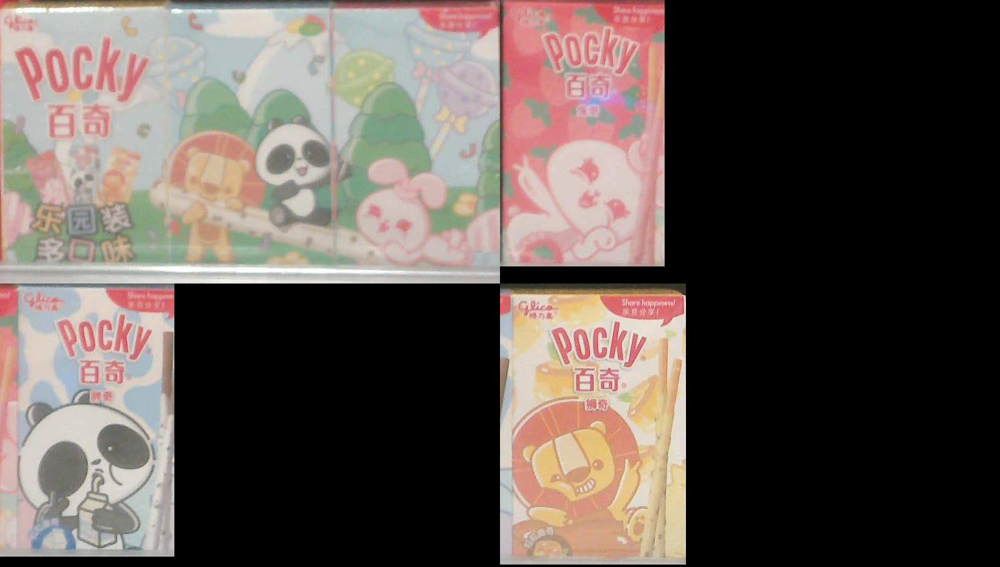

百奇乐园1_2 相似度计算 :  tensor([0.7055])
百奇乐园1 与猫相似度计算 :  tensor([0.4390])
百奇乐园1 与狗相似度计算 :  tensor([0.3721])


In [15]:
### 百奇乐园装
base_path='./data/Trax_bbox出来的小图含label_20230207/(复)百奇乐园装'

images_paths=[os.path.join(base_path,'1674956807534_3_1679.0_3063.5_820.0_465.0_0.0.jpg'),
              os.path.join(base_path,'1674956807534_3_2234.0_3057.5_270.0_437.0_0.0.jpg'),
              os.path.join(base_path,'1674956807534_3_2498.0_3062.0_286.0_448.0_0.0.jpg'),
              os.path.join(base_path,'1674956807534_3_2800.5_3060.5_305.0_461.0_0.0.jpg'),
              os.path.join(base_path,'1674956807842_2_1676.0_4396.5_820.0_487.0_0.0.jpg')]
image_百奇乐园,feature_百奇乐园=get_images_and_image_features(images_paths)
# 显示大图
display(image_百奇乐园)
print("百奇乐园1_2 相似度计算 : ", cosine_similarity(feature_百奇乐园[0], feature_百奇乐园[1]))
print("百奇乐园1 与猫相似度计算 : ", cosine_similarity(feature_百奇乐园[0],image_tensor_cat))
print("百奇乐园1 与狗相似度计算 : ", cosine_similarity(feature_百奇乐园[0],image_tensor_dog))




# 奥妙的图像相似度计算
奥妙相似度高于猫0.5，高于狗0.6，高于百奇乐园0.36，有很好的区分度

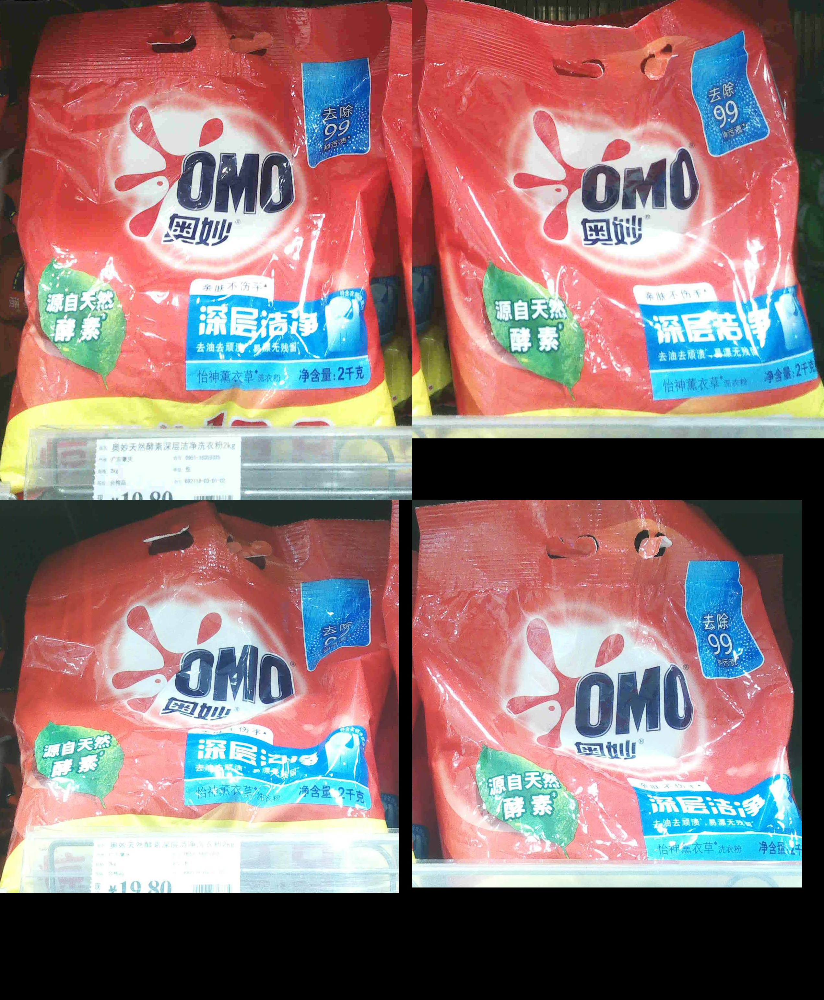

 奥妙1_2相似度计算:  tensor([0.9153])
 奥妙1和猫的相似度计算  :  tensor([0.4189])
 奥妙1和狗的相似度计算  :  tensor([0.3111])
 奥妙1和百奇乐园相似度计算  :  tensor([0.5506])


In [16]:
### 奥妙
base_path='./data/Trax_bbox出来的小图含label_20230207/(复)奥妙天然酵素深层洁净洗衣粉2KG'

images_paths=[os.path.join(base_path,'1674954934330_1_1423.5_3256.0_1271.0_1542.0_0.0.jpg'),
              os.path.join(base_path,'1674954934330_1_2585.5_3194.0_1275.0_1352.0_0.0.jpg'),
              os.path.join(base_path,'1674954934514_2_1386.0_1099.5_1230.0_1211.0_0.0.jpg'),
              os.path.join(base_path,'1674954934514_2_2557.5_997.5_1203.0_1195.0_0.0.jpg')]
image_奥妙,feature_奥妙=get_images_and_image_features(images_paths)
# 显示大图
display(image_奥妙)
print(" 奥妙1_2相似度计算: ", cosine_similarity(feature_奥妙[0], feature_奥妙[1]))
print(" 奥妙1和猫的相似度计算  : ", cosine_similarity(feature_奥妙[0], image_tensor_cat))
print(" 奥妙1和狗的相似度计算  : ", cosine_similarity(feature_奥妙[0], image_tensor_dog))
print(" 奥妙1和百奇乐园相似度计算  : ", cosine_similarity(feature_奥妙[0], feature_百奇乐园[0]))



# (复)特慧优马铃薯薄脆饼干(麻辣小龙虾味)150G


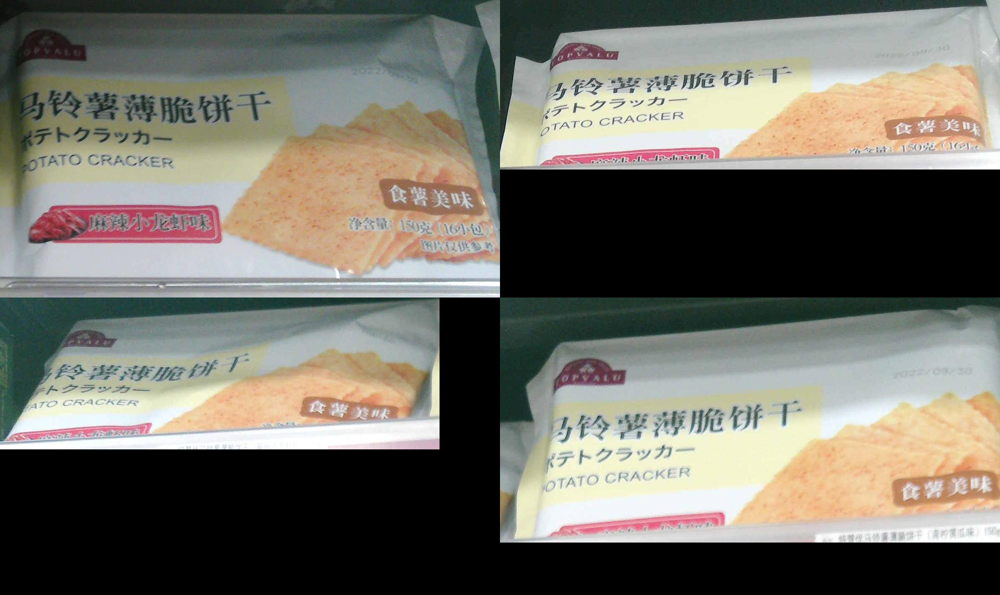

 特慧_麻辣小龙虾1_2相似度计算:  tensor([0.9089])
 特慧_麻辣小龙虾1和猫的相似度计算  :  tensor([0.4527])
 特慧_麻辣小龙虾1和狗的相似度计算  :  tensor([0.3392])
 特慧_麻辣小龙虾1和百奇乐园相似度计算  :  tensor([0.5591])


In [17]:
### 特慧_麻辣小龙虾
base_path='./data/Trax_bbox出来的小图含label_20230207/(复)特慧优马铃薯薄脆饼干(麻辣小龙虾味)150G'

images_paths=[os.path.join(base_path,'1674955680492_0_2869.5_2681.5_1191.0_709.0_0.0.jpg'),
              os.path.join(base_path,'1674955701465_2_2077.5_1065.0_1197.0_404.0_0.0.jpg'),
              os.path.join(base_path,'1674955701599_1_783.5_949.0_1047.0_362.0_0.0.jpg'),
              os.path.join(base_path,'1674955701599_1_1866.0_768.0_1234.0_584.0_0.0.jpg')]
image_特慧_麻辣小龙虾,feature_特慧_麻辣小龙虾=get_images_and_image_features(images_paths)
# 显示大图
display(image_特慧_麻辣小龙虾)
print(" 特慧_麻辣小龙虾1_2相似度计算: ", cosine_similarity(feature_特慧_麻辣小龙虾[0], feature_特慧_麻辣小龙虾[3]))
print(" 特慧_麻辣小龙虾1和猫的相似度计算  : ", cosine_similarity(feature_特慧_麻辣小龙虾[0], image_tensor_cat))
print(" 特慧_麻辣小龙虾1和狗的相似度计算  : ", cosine_similarity(feature_特慧_麻辣小龙虾[0], image_tensor_dog))
print(" 特慧_麻辣小龙虾1和百奇乐园相似度计算  : ", cosine_similarity(feature_特慧_麻辣小龙虾[0], feature_百奇乐园[0]))


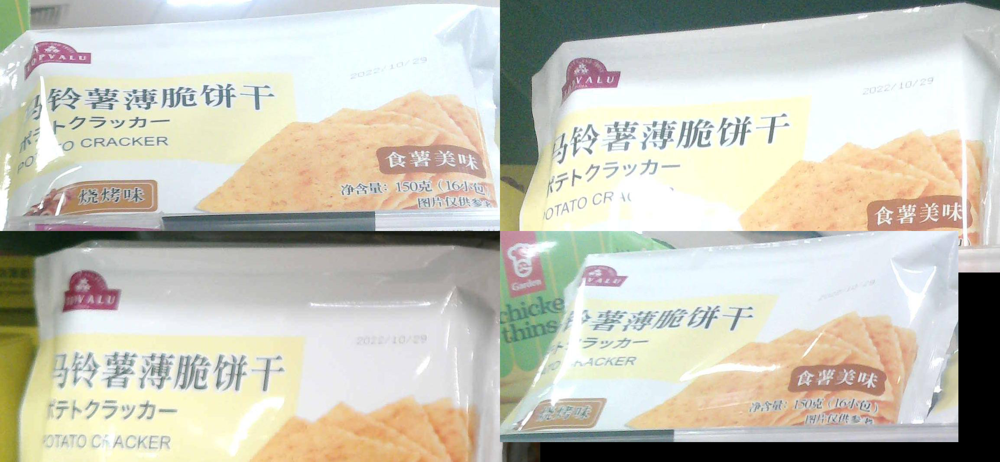

 特慧_烧烤1_2相似度计算:  tensor([0.8988])
 特慧_烧烤1和猫的相似度计算  :  tensor([0.4272])
 特慧_烧烤1和狗的相似度计算  :  tensor([0.3593])
 特慧_烧烤1和百奇乐园相似度计算  :  tensor([0.5468])
 特慧_麻辣小龙虾1与特慧_烧烤2相似度计算:  tensor([0.9082])


In [18]:
### 特慧_麻辣小龙虾
base_path='./data/Trax_bbox出来的小图含label_20230207/(复)特慧优马铃薯薄脆饼干(烧烤味)150G'

images_paths=[os.path.join(base_path,'1674955680492_0_2816.0_1656.0_1154.0_534.0_0.0.jpg'),
              os.path.join(base_path,'1674955701465_2_680.0_1023.0_1246.0_630.0_0.0.jpg'),
              os.path.join(base_path,'1674955701599_1_800.5_3089.0_1247.0_814.0_0.0.jpg'),
              os.path.join(base_path,'1674955701666_0_684.0_1702.0_1058.0_488.0_0.0.jpg')]
image_特慧_烧烤,feature_特慧_烧烤=get_images_and_image_features(images_paths)
# 显示大图
display(image_特慧_烧烤)
print(" 特慧_烧烤1_2相似度计算: ", cosine_similarity(feature_特慧_烧烤[0], feature_特慧_烧烤[1]))
print(" 特慧_烧烤1和猫的相似度计算  : ", cosine_similarity(feature_特慧_烧烤[0], image_tensor_cat))
print(" 特慧_烧烤1和狗的相似度计算  : ", cosine_similarity(feature_特慧_烧烤[0], image_tensor_dog))
print(" 特慧_烧烤1和百奇乐园相似度计算  : ", cosine_similarity(feature_特慧_烧烤[0], feature_百奇乐园[0]))
print(" 特慧_麻辣小龙虾1与特慧_烧烤2相似度计算: ", cosine_similarity(feature_特慧_麻辣小龙虾[0], feature_特慧_烧烤[2]))
